## 臉部偵測與辨識

In [1]:
# 起手式
import sys,  time
import ipywidgets as widget
from ipywidgets import interact
from IPython.display import display
import numpy as np
import cv2
from PIL import Image
from io import BytesIO
def to_pil(ima):
    if ima.dtype == np.float64:
        ima = (ima*255).clip(0,255).astype('uint8')
    return Image.fromarray(ima)
    
def img_to_png(ima, cvt=None):
    if cvt:
        ima = cv2.cvtColor(ima, cvt)
    im = to_pil(ima)
    bio = BytesIO()
    im.save(bio, format='png')
    return bio.getvalue()

In [2]:
# 讀取已經學習過的臉部以及眼睛偵測 haar cascade
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_eye.xml')

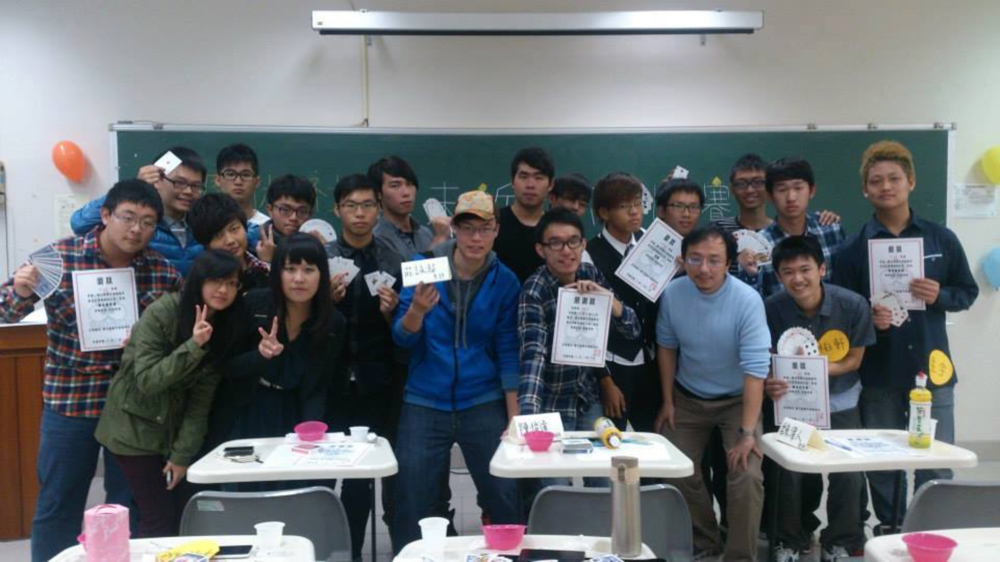

In [3]:
# 東華魔術社近距離比賽照片
img = Image.open("img/magic_faces.jpg")
# 轉成陣列
img = np.array(img)
# 放大兩倍，比較好找
img = cv2.resize(img, (img.shape[1]*2, img.shape[0]*2))
# 灰階圖
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
# 顯示
to_pil(img)

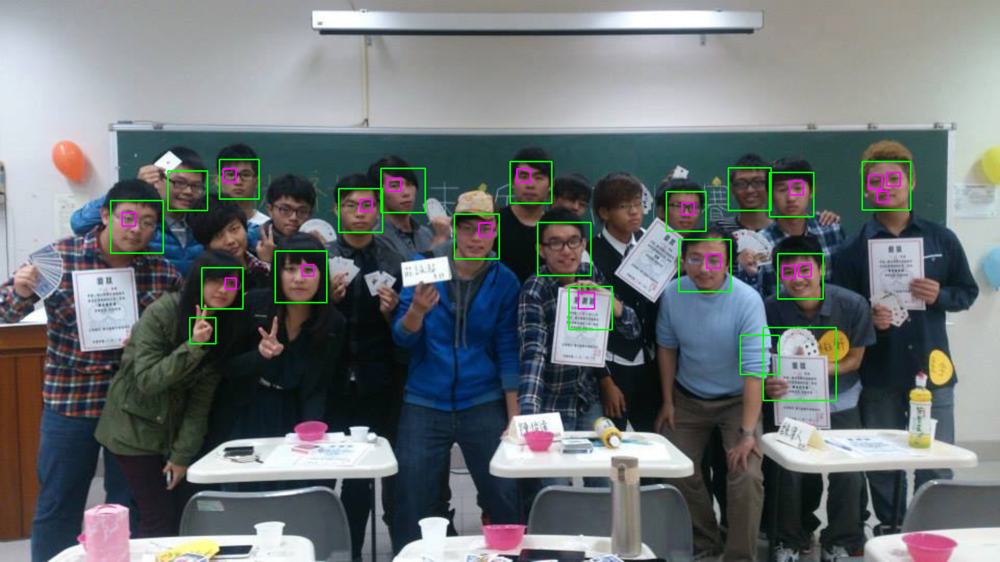

In [4]:
# 從裡面來找找看臉吧
faces = face_cascade.detectMultiScale(gray, 1.1, 5)
# 從每個找到的裡面，再去找眼睛
for (x,y,w,h) in faces:
    # 畫綠色的長方形
    cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),2)
    # 專注在臉部的小長方形圖
    roi_gray = gray[y:y+h, x:x+w]
    roi_color = img[y:y+h, x:x+w]
    # 從小長方形灰階圖中間去找眼睛
    eyes = eye_cascade.detectMultiScale(roi_gray)
    # 畫出眼睛的方塊
    for (ex,ey,ew,eh) in eyes:
        cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(255,0,255),2)
to_pil(img)

In [5]:
# 另外一種臉部偵測方式，使用 dlib
import dlib
fd = dlib.get_frontal_face_detector()


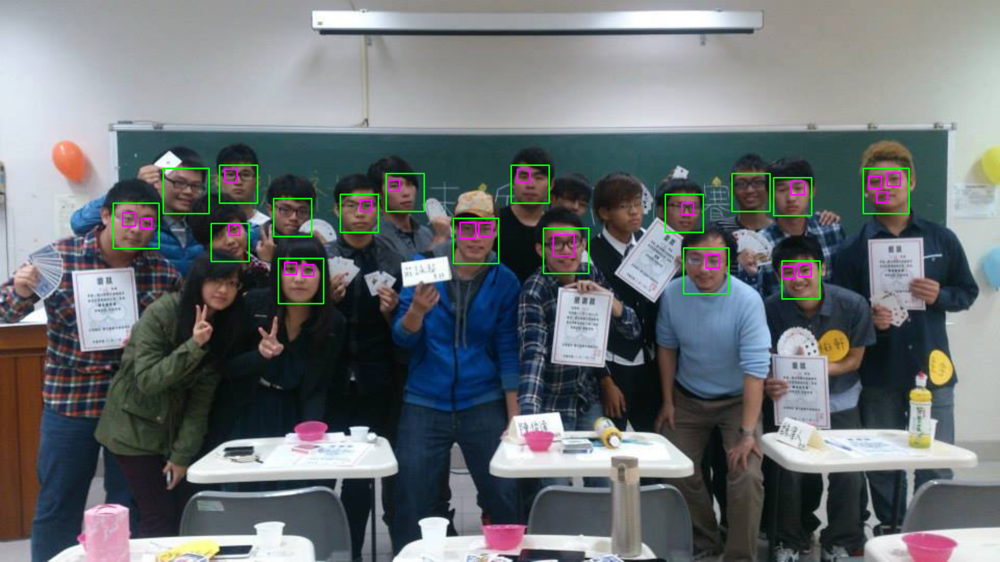

In [7]:
def find_faces(fn):
    img = Image.open(fn)
    img = np.array(img)
    img = cv2.resize(img, (img.shape[1]*2, img.shape[0]*2))
    #img = cv2.resize(img, (200,400))
    rl = fd(img)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #faces = face_cascade.detectMultiScale(gray, 1.1, 5, minSize=(5,5), maxSize=(1000,1000))
    #for (x,y,w,h) in faces:
    for r in rl:
        x,y,w,h = r.left(), r.top(), r.width(), r.height()
        cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),2)
        roi_gray = gray[y:y+h, x:x+w]
        roi_color = img[y:y+h, x:x+w]
        eyes = eye_cascade.detectMultiScale(roi_gray)
        for (ex,ey,ew,eh) in eyes:
            cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(255,0,255),2)
    return to_pil(img)
find_faces("img/magic_faces.jpg")

# Photo files from https://www.flickr.com/photos/76636751@N06/albums

In [8]:
#!wget dropbox-url
#!unzip x zipfile
#!ls

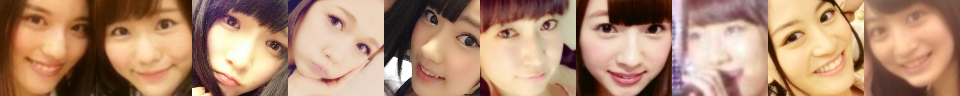

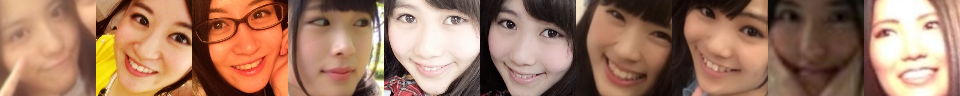

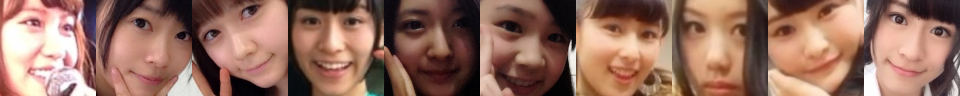

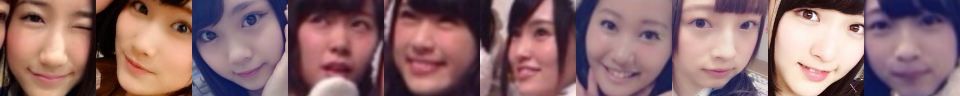

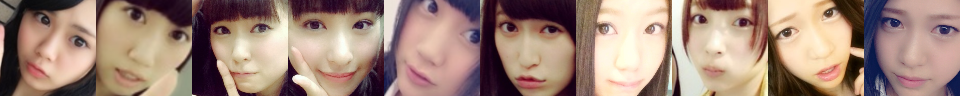

...

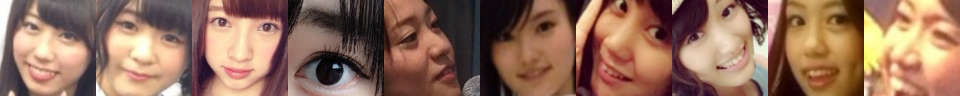

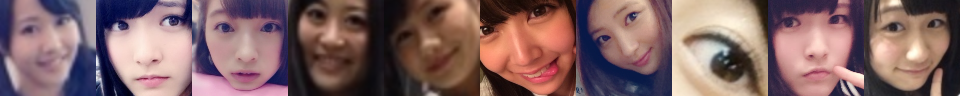

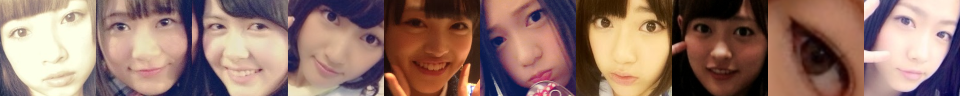

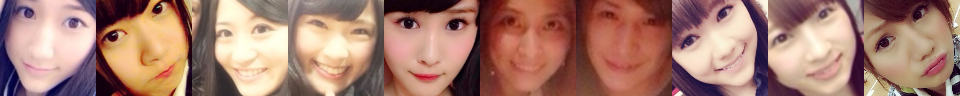

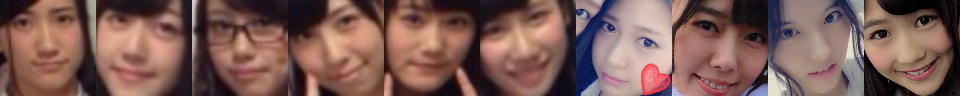

In [9]:
import glob
color_faces = []
gray_faces = []
for fn in glob.glob("akb48/*.jpg"):
    img = Image.open(fn)
    img = np.array(img)
    img0 = img = cv2.resize(img, (img.shape[1]*2, img.shape[0]*2))
    #rows,cols = img0.shape[:2]
    #for deg in range(-45, 46, 45):
    #    M = cv2.getRotationMatrix2D((cols/2,rows/2),deg,1)
    #    img = cv2.warpAffine(img0,M,(cols,rows))
    if 1:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        #faces = face_cascade.detectMultiScale(gray, 1.3, 5)
        #for (x,y,w,h) in faces:
        rl = fd(img)
        for r in rl:
            x,y,w,h = r.left(), r.top(), r.width(), r.height()
            if x<0 or y <0:
                continue
            roi_color = cv2.resize(img[y:y+h, x:x+w], (96,96))
            roi_gray = cv2.cvtColor(roi_color, cv2.COLOR_RGB2GRAY)
            roi_gray = cv2.equalizeHist(roi_gray)
            color_faces.append(roi_color.copy())
            gray_faces.append(roi_gray)
            if len(color_faces)%10 == 0:
                out_img = np.concatenate(color_faces[-10:], axis=1)
                display(to_pil(out_img))
        #display(to_pil(roi_gray))


In [10]:
idx=np.arange(len(gray_faces))
np.random.shuffle(idx)
gray_faces = np.array(gray_faces)
color_faces = np.array(color_faces)
gray_faces=gray_faces[idx]
color_faces=color_faces[idx]

In [11]:
model = cv2.face.createLBPHFaceRecognizer()

In [12]:
labels=np.arange(len(gray_faces)-100)

In [13]:
model.train(gray_faces[:-100], labels)

(231, 115.01443800372377)


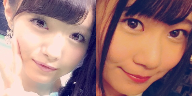

(364, 108.69597233216025)


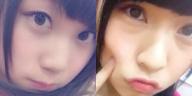

(306, 118.70732629940566)


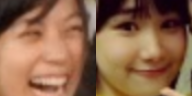

(115, 114.01884641800964)


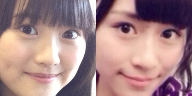

(385, 101.64949309853414)


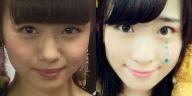

(253, 105.39229649414072)


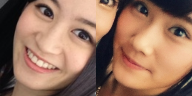

(298, 108.45461204181741)


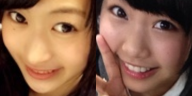

(59, 115.26780187220217)


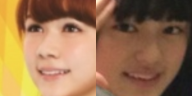

(143, 99.9698298503741)


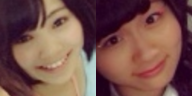

(97, 98.16954028203197)


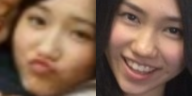

(286, 104.95497871983709)


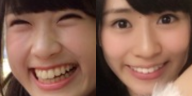

(379, 117.85576718482905)


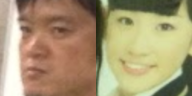

(307, 97.09058261649837)


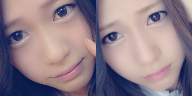

(135, 103.38585943285521)


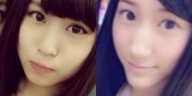

(350, 116.1885626160493)


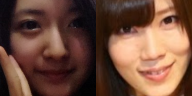

(349, 107.15495026509385)


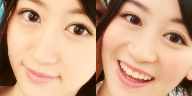

(270, 104.21051902117308)


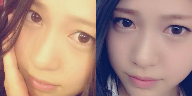

(235, 108.90767458733467)


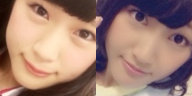

(290, 123.38638405009482)


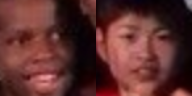

(332, 100.1630095076164)


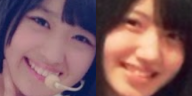

(464, 106.71142017555027)


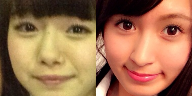

(235, 110.06382757894356)


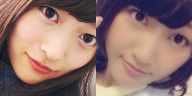

(423, 94.79861987267348)


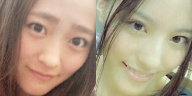

(340, 105.81894617479013)


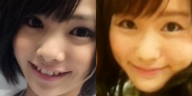

(371, 92.53354479245641)


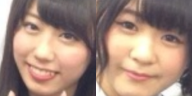

(157, 107.98493625412131)


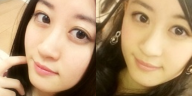

(97, 109.07528146272274)


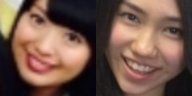

(263, 118.7475241904182)


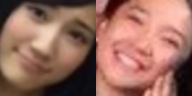

(24, 109.79872362388599)


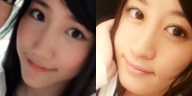

(139, 96.53337574714793)


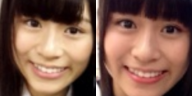

(201, 103.84125167854423)


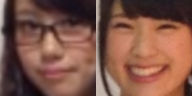

(37, 120.7770550855749)


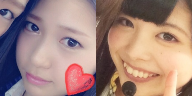

(269, 111.0424403619215)


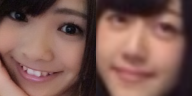

(228, 107.85735145144383)


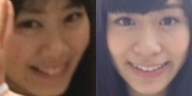

(91, 112.42569683666555)


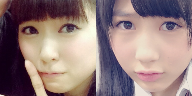

(353, 98.15668413707628)


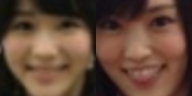

(286, 100.44006555518268)


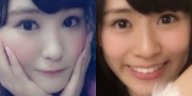

(336, 107.41488794742583)


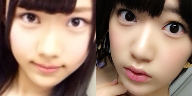

(332, 126.03938345546497)


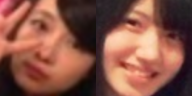

(383, 102.71556749978335)


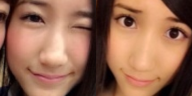

(410, 110.20969135475124)


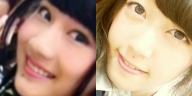

(231, 101.82031585835729)


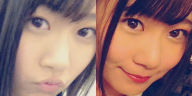

(427, 103.01762323253205)


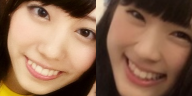

(512, 114.73454062587642)


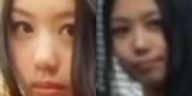

(138, 107.42807058264253)


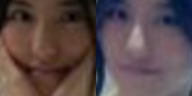

(427, 112.9403023561299)


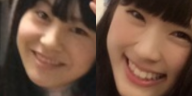

(201, 106.09855353317667)


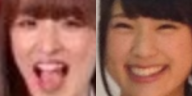

(424, 111.81534847959415)


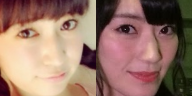

(465, 118.00113005781704)


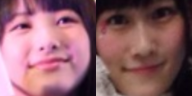

(94, 113.6217094371375)


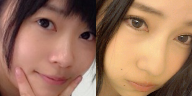

(314, 101.59303385370924)


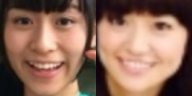

(154, 112.49921343305662)


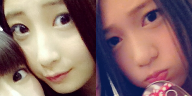

(91, 103.4440489719876)


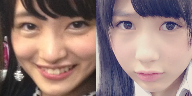

(0, 113.41339239139582)


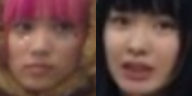

(436, 106.08076036475875)


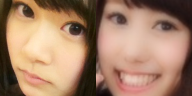

(345, 113.94750304060236)


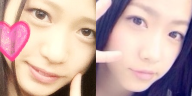

(187, 98.03063605348095)


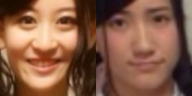

(478, 120.16103070869349)


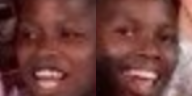

(320, 110.01572948470182)


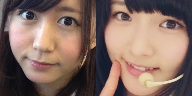

(226, 109.76621058576451)


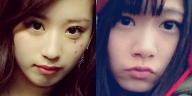

(187, 108.452996997114)


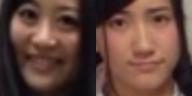

(250, 110.11397962364583)


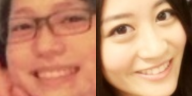

(7, 110.7878525688211)


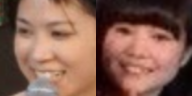

(253, 104.53055718866794)


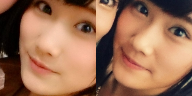

(187, 103.22729602859702)


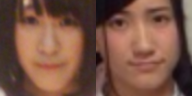

(463, 103.86697946207248)


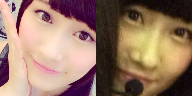

(97, 109.4778125310543)


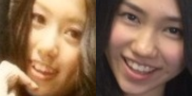

(495, 105.99237880359166)


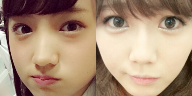

(474, 101.21328945400424)


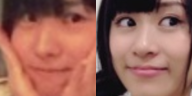

(194, 106.17382050094487)


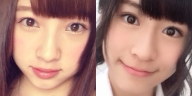

(118, 112.37041909928638)


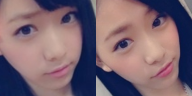

(502, 107.89690774726127)


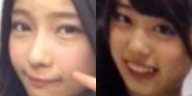

(288, 112.0561956787533)


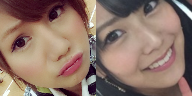

(79, 106.37221078321672)


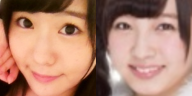

(87, 107.44543952680448)


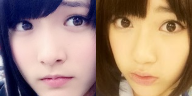

(7, 110.72946135329732)


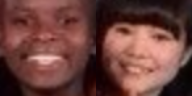

(191, 112.34169243701773)


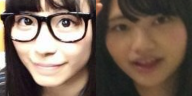

(9, 130.44116506276353)


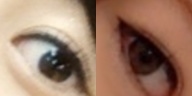

(311, 99.15457903927546)


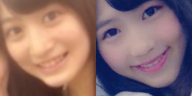

(430, 115.69542892350694)


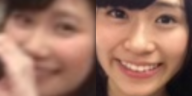

(271, 112.07841371865463)


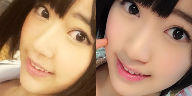

(113, 112.20750801776899)


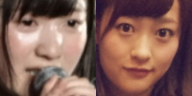

(205, 99.67165988125221)


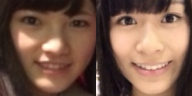

(145, 116.27225464669951)


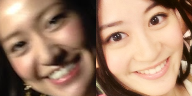

(442, 124.0472128539398)


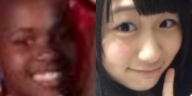

(3, 107.19614917700275)


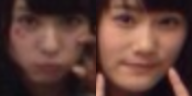

(55, 95.54577129574625)


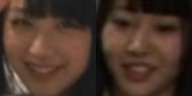

(351, 105.30174973395552)


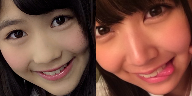

(428, 104.45121020811371)


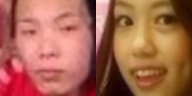

(256, 110.46940448454527)


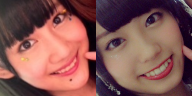

(220, 103.69855512309523)


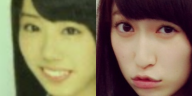

(96, 98.83103496723302)


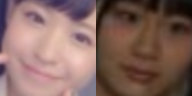

(212, 119.46003213119424)


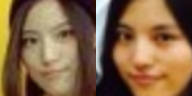

(421, 98.25208036158755)


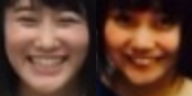

(262, 103.00785735781065)


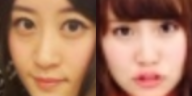

(163, 120.78879167787572)


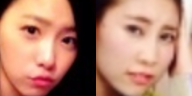

(28, 99.50912514533033)


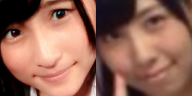

(261, 106.24913309873726)


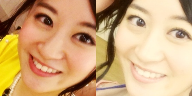

(71, 92.84285040325196)


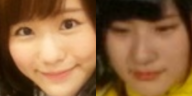

(321, 101.21688846166892)


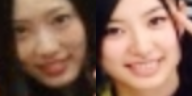

In [14]:
for i in range(100):
    r = model.predict(gray_faces[-i-1])
    print(r)
    img1 = color_faces[-i-1]
    img2 = color_faces[r[0]]
    display(to_pil(np.concatenate([img1, img2], axis=1)))